<br>CSC475</br>
<br>Assignment 6</br>
<br>Yajun Wan (V00895974)</br>

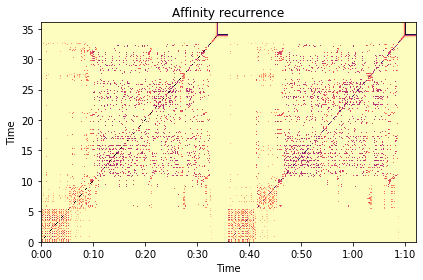

In [256]:
#Q1_1
import librosa
import librosa.display
import numpy as np
import matplotlib.pyplot as plt
import IPython.display as ipd
import soundfile as sf


audio,srate = librosa.load("rock.wav")
audio2 = np.hstack([audio,audio])
hop_length = 1024
y_ref, sr = librosa.load("rock.wav")
sf.write("audio2.wav",audio2,srate)
y_comp, sr = librosa.load("audio2.wav")
mfcc_ref = librosa.feature.mfcc(y=y_ref, sr=sr, hop_length=hop_length)
mfcc_comp = librosa.feature.mfcc(y=y_comp, sr=sr, hop_length=hop_length)
xsim_aff = librosa.segment.cross_similarity(mfcc_comp, mfcc_ref,mode = "affinity")

plt.figure()
librosa.display.specshow(xsim_aff, x_axis='time', y_axis='time',cmap='magma_r', hop_length=hop_length)
plt.title('Affinity recurrence')
plt.tight_layout()

Comparisons between 30sec of the audio and 60sec of the repetition. The left half of the figure behaves the same as the right half of the figure.

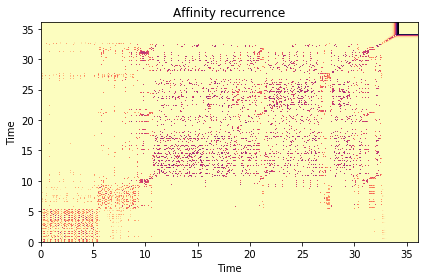

In [257]:
#Q1_2
hop_length = 1024
y_ref, sr = librosa.load("rock.wav")
y_comp, sr = librosa.load("rock.wav")
mfcc_ref = librosa.feature.mfcc(y=y_ref, sr=sr, hop_length=hop_length)
mfcc_comp = librosa.feature.mfcc(y=y_comp, sr=sr, hop_length=hop_length)
xsim_aff = librosa.segment.cross_similarity(mfcc_comp, mfcc_ref,mode = "affinity")

plt.figure()
librosa.display.specshow(xsim_aff, x_axis='time', y_axis='time',cmap='magma_r', hop_length=hop_length)
plt.title('Affinity recurrence')
plt.tight_layout()

There are three blocks in the figure above, first is from 0 to 10sec, second is roughly from 11sec to 32.5sec, and the last is from 25sec to 30sec.

In [258]:
sample1 = y_ref[5*sr:25*sr]
ipd.Audio(sample1,rate = sr)

In [259]:
sample2 = y_ref[25*sr:30*sr]
ipd.Audio(sample2,rate = sr)

The second block shows the time interval for chorus,the left two blocks are verse.

In [260]:
#Q1_3
audio_length = len(audio)

#first 10 sec
audio_clip1 = audio[0:10*sr]
#last 10 sec
audio_clip2 = audio[20*sr:audio_length]
#middle 10 sec
original_audio_clip = audio[10*sr:20*sr]

slower_clip = librosa.effects.time_stretch(audio_clip1,0.75)
quicker_clip = librosa.effects.time_stretch(audio_clip2,1.25)

mixed_audio = np.hstack([slower_clip,original_audio_clip,quicker_clip])
sf.write("mixed_audio.wav",mixed_audio,sr)
ipd.Audio("mixed_audio.wav",rate = sr)


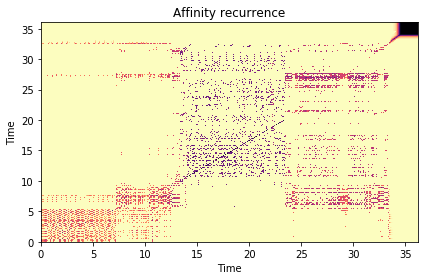

In [261]:
y_ref, sr = librosa.load("rock.wav")
y_comp, sr = librosa.load("mixed_audio.wav")
mfcc_ref = librosa.feature.mfcc(y=y_ref, sr=sr, hop_length=hop_length)
mfcc_comp = librosa.feature.mfcc(y=y_comp, sr=sr, hop_length=hop_length)
xsim_aff = librosa.segment.cross_similarity(mfcc_comp, mfcc_ref,mode = 'affinity')

plt.figure()
librosa.display.specshow(xsim_aff, x_axis='time', y_axis='time',cmap='magma_r', hop_length=hop_length)
plt.title('Affinity recurrence')
plt.tight_layout()

The chorus has shrinked while the verse has stretched

In [262]:
#Q1_4
D = librosa.stft(audio)
D_harmonic, D_percussive = librosa.decompose.hpss(D)
harmonic = librosa.istft(D_harmonic)
sf.write("har.wav",harmonic,sr)
ipd.Audio(harmonic,rate = sr)

In [263]:
percussive = librosa.istft(D_percussive)
sf.write("per.wav",percussive,sr)
ipd.Audio(percussive,rate = sr)

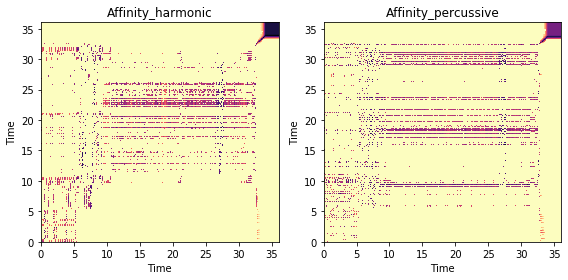

In [264]:
hop_length = 1024
#harmonic
y_ref_har, sr = librosa.load("har.wav")
y_comp_har, sr = librosa.load("rock.wav")
mfcc_ref_har = librosa.feature.mfcc(y=y_ref_har, sr=sr, hop_length=hop_length)
mfcc_comp_har = librosa.feature.mfcc(y=y_comp_har, sr=sr, hop_length=hop_length)
#percussiv
y_ref_per, sr = librosa.load("per.wav")
y_comp_per, sr = librosa.load("rock.wav")
mfcc_ref_per = librosa.feature.mfcc(y=y_ref_per, sr=sr, hop_length=hop_length)
mfcc_comp_per = librosa.feature.mfcc(y=y_comp_per, sr=sr, hop_length=hop_length)

xsim_aff_har = librosa.segment.cross_similarity(mfcc_comp_har, mfcc_ref_har,mode = "affinity")
xsim_aff_per = librosa.segment.cross_similarity(mfcc_comp_per, mfcc_ref_per,mode = "affinity")

plt.figure(figsize=(8, 4))
plt.subplot(1, 2, 1)
librosa.display.specshow(xsim_aff_har, x_axis='time', y_axis='time',cmap='magma_r', hop_length=hop_length)
plt.title('Affinity_harmonic')
plt.subplot(1, 2, 2)
librosa.display.specshow(xsim_aff_per, x_axis='time', y_axis='time',cmap='magma_r', hop_length=hop_length)
plt.title('Affinity_percussive')
plt.tight_layout()

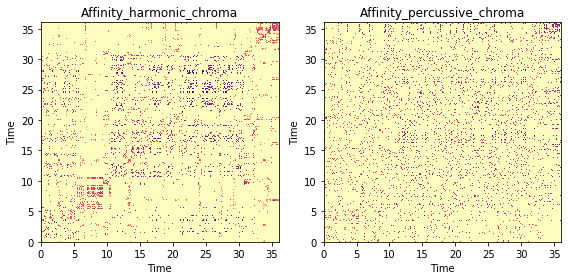

In [265]:
#harmonic
y_ref_har, sr = librosa.load("har.wav")
y_comp_har, sr = librosa.load("har.wav")
chroma_ref_har = librosa.feature.chroma_stft(y=y_ref_har, sr=sr, hop_length=hop_length)
chroma_comp_har = librosa.feature.chroma_stft(y=y_comp_har, sr=sr, hop_length=hop_length)
#percussiv
y_ref_per, sr = librosa.load("per.wav")
y_comp_per, sr = librosa.load("per.wav")
chroma_ref_per = librosa.feature.chroma_stft(y=y_ref_per, sr=sr, hop_length=hop_length)
chroma_comp_per = librosa.feature.chroma_stft(y=y_comp_per, sr=sr, hop_length=hop_length)

xsim_aff_har = librosa.segment.cross_similarity(chroma_comp_har, chroma_ref_har,mode = "affinity")
xsim_aff_per = librosa.segment.cross_similarity(chroma_comp_per, chroma_ref_per,mode = "affinity")

plt.figure(figsize=(8, 4))
plt.subplot(1, 2, 1)
librosa.display.specshow(xsim_aff_har, x_axis='time', y_axis='time',cmap='magma_r', hop_length=hop_length)
plt.title('Affinity_harmonic_chroma')
plt.subplot(1, 2, 2)
librosa.display.specshow(xsim_aff_per, x_axis='time', y_axis='time',cmap='magma_r', hop_length=hop_length)
plt.title('Affinity_percussive_chroma')
plt.tight_layout()

For harmonic, both figure can tell the allocation for each feature block, but the figure that with Chroma is more precise.
As for percussive, the figure without Chroma tends to be more clear.

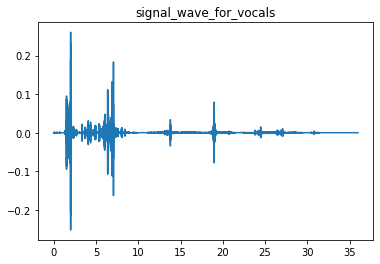

In [322]:
#Q2_1
#I have used command prompt to separate 4 stems, spleeter separate -i rock.wav -p spleeter:4stems -o output
#no code included

audio,sr = librosa.load("vocals.wav")
vocal = librosa.stft(audio)
vocal = librosa.istft(vocal)
time = np.linspace(0,len(vocal)/srate,num = len(vocal))
plt.figure(1)
plt.title("signal_wave_for_vocals")
plt.plot(time,vocal)
ipd.Audio(audio,rate = sr)

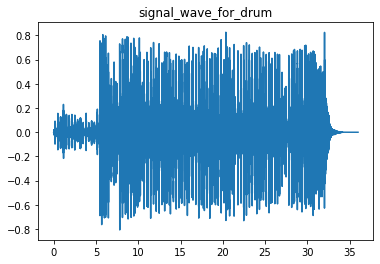

In [267]:
audio,srate = librosa.load("drums.wav")
vocal = librosa.stft(audio)
drum = librosa.istft(vocal)
time = np.linspace(0,len(drum)/srate,num = len(drum))
plt.figure(1)
plt.title("signal_wave_for_drum")
plt.plot(time,drum)

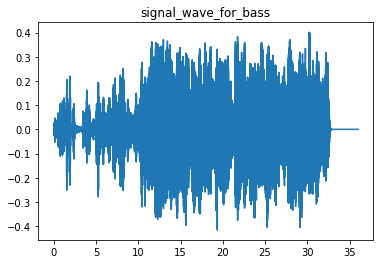

In [268]:
audio,srate = librosa.load("bass.wav")
vocal = librosa.stft(audio)
bass = librosa.istft(vocal)
time = np.linspace(0,len(bass)/srate,num = len(bass))
plt.figure(1)
plt.title("signal_wave_for_bass")
plt.plot(time,bass)

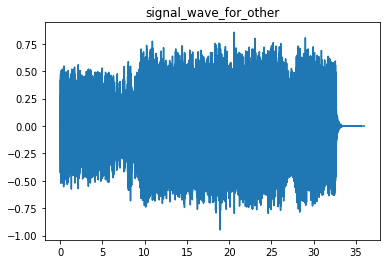

In [269]:
audio,srate = librosa.load("other.wav")
vocal = librosa.stft(audio)
other = librosa.istft(vocal)
time = np.linspace(0,len(other)/srate,num = len(other))
plt.figure(1)
plt.title("signal_wave_for_other")
plt.plot(time,other)

The sound of vocal is not that clear and somehow it goes into the vocal file, the separator works well on bass and drum,however the bass sounds deep and low due to lower peak amplitudes compared to drum. 

In [270]:
#Q2_2
vocal,srate= librosa.load("vocals.wav")
drum,srate = librosa.load("drums.wav")
bass,srate = librosa.load("bass.wav")
other,srate = librosa.load("other.wav")
y_third = librosa.effects.pitch_shift(vocal,srate, n_steps=4)
mix_audio = np.vstack([y_third,drum,bass,other])
ipd.Audio(mix_audio,rate = srate)

the vocal has been shifted up, it becomes more sharp

In [277]:
#Q2_3
def sonify(amp_track, pitch_track, srate, hop_size):

    times = np.arange(0.0, float(hop_size * len(pitch_track)) / srate,
                      float(hop_size) / srate)

    # sample locations in time (seconds)                                                      
    sample_times = np.linspace(0, np.max(times), int(np.max(times)*srate-1))

    # create linear interpolators for frequencies and amplitudes                              
    # so that we have a frequency and amplitude value for 
    # every sample 
    freq_interpolator = interp1d(times,pitch_track)
    amp_interpolator = interp1d(times,amp_track)

    # use the interpolators to calculate per sample frequency and                             
    # ampitude values                                                                         
    sample_freqs = freq_interpolator(sample_times)
    sample_amps  = amp_interpolator(sample_times)

    # create audio signal                                                                     
    audio = np.zeros(len(sample_times));
    T = 1.0 / srate
    phase = 0.0
    
    # update phase according to the sample frequencies 
    for i in range(1, len(audio)):
        audio[i] = sample_amps[i] * np.sin(phase)
        phase = phase + (2*np.pi*T*sample_freqs[i])

    return audio

def pitch_fft(frame, srate): 
    mag = np.abs(np.fft.fft(frame))
    mag = mag[0:int(len(mag)/2)]
    pitch_estimate = np.argmax(mag) * (srate / len(frame))
    return pitch_estimate
def pitch_track(signal, hopSize, winSize, extractor): 
    offsets = np.arange(0, len(signal), hopSize)
    pitch_track = np.zeros(len(offsets))
    amp_track = np.zeros(len(offsets))
    
    for (m,o) in enumerate(offsets): 
        frame = signal[o:o+winSize] 
        pitch_track[m] = extractor(frame, srate)
        amp_track[m] = np.sqrt(np.mean(np.square(frame)))  

        if (pitch_track[m] > 1500): 
            pitch_track[m] = 0 
        
    return (amp_track, pitch_track)

from scipy.interpolate import interp1d 
vocal,srate= librosa.load('vocal.wav')
at1, pt1= pitch_track(vocal,256,512,pitch_fft)
pt1_audio = sonify(at1, pt1, srate, 256)
mix1 = np.vstack([drum[0:len(pt1_audio)],pt1_audio])
ipd.Audio(mix1,rate = srate)



Unfortunately,it is hard to identify the song after sonify it.

In [280]:
#Q2_4
print("The length of the drum track is",len(drum))

The length of the drum track is 793800


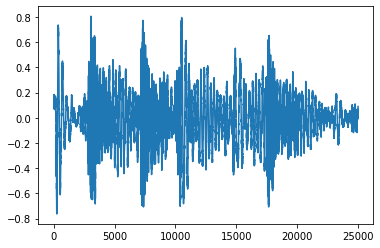

In [285]:
plt.plot(drum[125000:150000])

In [289]:
ipd.Audio(drum[125000:150000],rate = srate)

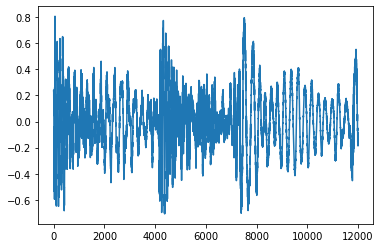

In [292]:
plt.plot(drum[128000:140000])

We can generate that the peak amplitude for snare is above 0.6,while kick drum's peak is over 0.3

Text(0.5, 1.0, 'Figure for snare drum')

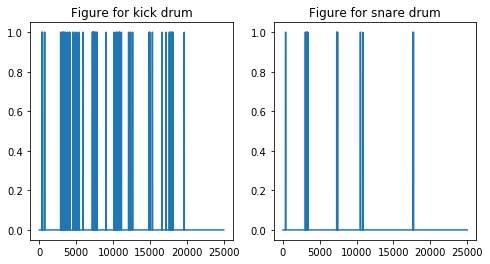

In [305]:
def drum_detection(audio):
    snare = []
    kick = []
    for i in range(len(audio)):
        if audio[i] > 0.6:
            snare.append(i)
        elif audio[i] > 0.35:
            kick.append(i)
    return kick, snare

kick,snare = drum_detection(drum)

k = np.zeros(len(drum))
for i in kick:
    k[i] = 1
s = np.zeros(len(drum))
for i in snare:
    s[i] = 1

plt.figure(figsize=(8, 4))
plt.subplot(1, 2, 1)
plt.plot(k[125000:150000])
plt.title('Figure for kick drum')
plt.subplot(1, 2, 2)
plt.plot(s[125000:150000])
plt.title('Figure for snare drum')

In [319]:
#I didn't find the kick and snare-hop wav file, so I downloaded a one-sec sound sample for both kick drum and snare drum
#And I will repeat it to match the length of vocal audio file
kick,sr = librosa.load("kick.wav")
snare,sr = librosa.load("snare.wav")
kick_repeat_time = int(len(other)/len(kick))+1
snare_repeat_time = int(len(other)/len(snare))+1
kick_drum = []
snare_drum = []
for i in range(kick_repeat_time):
    kick_drum = np.concatenate((kick_drum,kick))
for i in range(snare_repeat_time):
    snare_drum = np.concatenate((snare_drum,snare))
ipd.Audio(kick_drum,rate = sr)